In [1]:
import matplotlib.pyplot as plt
from dotenv import load_dotenv
from sklearn.model_selection import train_test_split
from tqdm import tqdm

from src.utils import *

### Ziskanie cesty k datasetu

In [2]:
load_dotenv()
DATASET_PATH = os.getenv("DATASET_PATH")
if not DATASET_PATH:
    raise ValueError("You need to set DATASET_PATH environment variable, ")
    exit(1);
if not Path(DATASET_PATH).exists() or not Path(DATASET_PATH).is_dir():
    raise ValueError("Path is not a valid path, link to dataset is in readme")

In [3]:
# 10 zvierat na klasifikáciu
print(os.listdir(DATASET_PATH))

['cane', 'cavallo', 'elefante', 'farfalla', 'gallina', 'gatto', 'mucca', 'pecora', 'ragno', 'scoiattolo']


In [4]:
# Zistenie formátov obrázkov v datasete
exts = find_image_extensions(DATASET_PATH)
print("Nájdené formáty:", exts)


Nájdené formáty: {'.jpg', '.jpeg', '.png'}


## Loading dataframe

In [5]:
# nacitanie celeho datasetu
ANIMALS_DF = load_dataset_info(DATASET_PATH)
ANIMALS_DF.head()

,filepath,label,format,color_mode,bit_depth,width,height,area,aspect_ratio,brightness
0,data\archive\raw-img\cane\OIF-e2bexWrojgtQnAPP...,cane,.jpeg,RGB,8,300,225,67500,1.333333,162.620696
1,data\archive\raw-img\cane\OIP---A27bIBcUgX1qkb...,cane,.jpeg,RGB,8,300,214,64200,1.401869,171.896558
2,data\archive\raw-img\cane\OIP---cByAiEbIxIAleG...,cane,.jpeg,RGB,8,153,300,45900,0.510000,121.562360
3,data\archive\raw-img\cane\OIP---ZIdwfUcJeVxnh4...,cane,.jpeg,RGB,8,300,225,67500,1.333333,121.487343
4,data\archive\raw-img\cane\OIP---ZRsOF7zsMqhW30...,cane,.jpeg,RGB,8,300,225,67500,1.333333,113.152356


In [6]:
print("Počet obrázkov celkovo:", len(ANIMALS_DF))
print("---Kategórie---")
print(ANIMALS_DF["label"].value_counts())
print("---Formáty---")
print(ANIMALS_DF["format"].value_counts())

Počet obrázkov celkovo: 26179
---Kategórie---
label
cane          4863
ragno         4821
gallina       3098
cavallo       2623
farfalla      2112
mucca         1866
scoiattolo    1862
pecora        1820
gatto         1668
elefante      1446
Name: count, dtype: int64
---Formáty---
format
.jpeg    24209
.jpg      1919
.png        51
Name: count, dtype: int64


C:\Users\ZEPHY\Documents\Repositories\zneus\ZNEUS-ANIMALS-REPRISE\src\utils\images.py:13: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  sampled = groups.apply(lambda g: g.sample(min(n, len(g)), random_state=42))



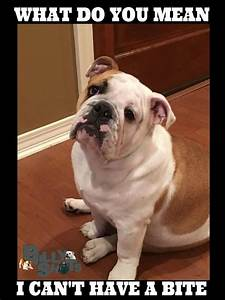
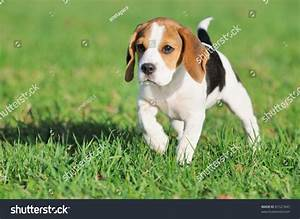
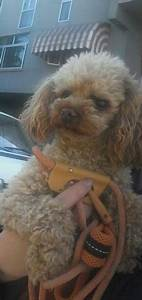
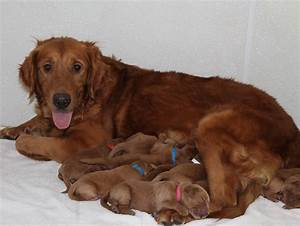
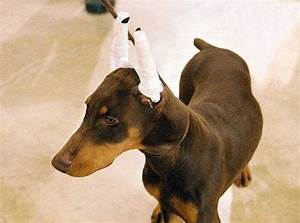
...
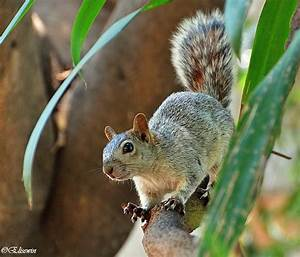
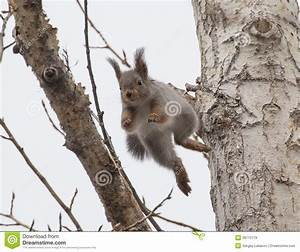
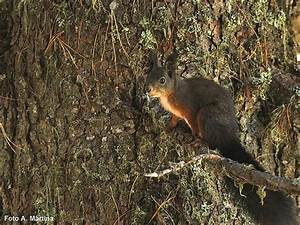
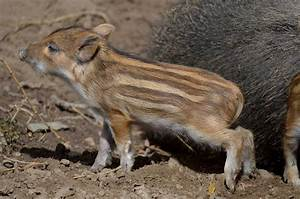
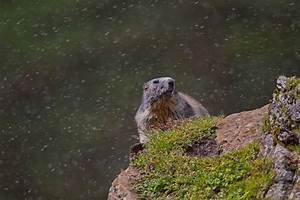

In [7]:
samples = sample_per_class(ANIMALS_DF, n=5)
show_images(samples, title="Random samples z každej kategórie")


In [8]:
# kontrola a odstanenie poskodenych obrazkov
bad_images = []
sizes = []

for path in tqdm(ANIMALS_DF["filepath"], desc="Kontrola obrázkov"):
    try:
        # verify = skontroluje len header JPG/PNG (rýchle)
        with Image.open(path) as img:
            img.verify()

        # druhé otvorenie = načíta pixely (nutné pre rozmery)
        with Image.open(path) as img:
            sizes.append(img.size)

    except Exception as e:
        bad_images.append(path)
        sizes.append((None, None))

ANIMALS_DF["is_corrupted"] = ANIMALS_DF["width"].isna()

print("Poškodené obrázky:", ANIMALS_DF["is_corrupted"].sum())

bad_df = ANIMALS_DF[ANIMALS_DF["is_corrupted"] == True]
if not bad_df.empty:
    display(bad_df)


Kontrola obrázkov: 100%|██████████| 26179/26179 [00:05<00:00, 4908.37it/s]

Poškodené obrázky: 0


          width    height  aspect_ratio         area
count  26179.00  26179.00      26179.00     26179.00
mean     320.04    252.63          1.31    106436.26
std      196.94    148.40          0.31    652805.56
min       60.00     57.00          0.29      3420.00
25%      300.00    200.00          1.14     60000.00
50%      300.00    225.00          1.33     67500.00
75%      300.00    300.00          1.50     74100.00
max     6720.00   6000.00          4.23  30105600.00


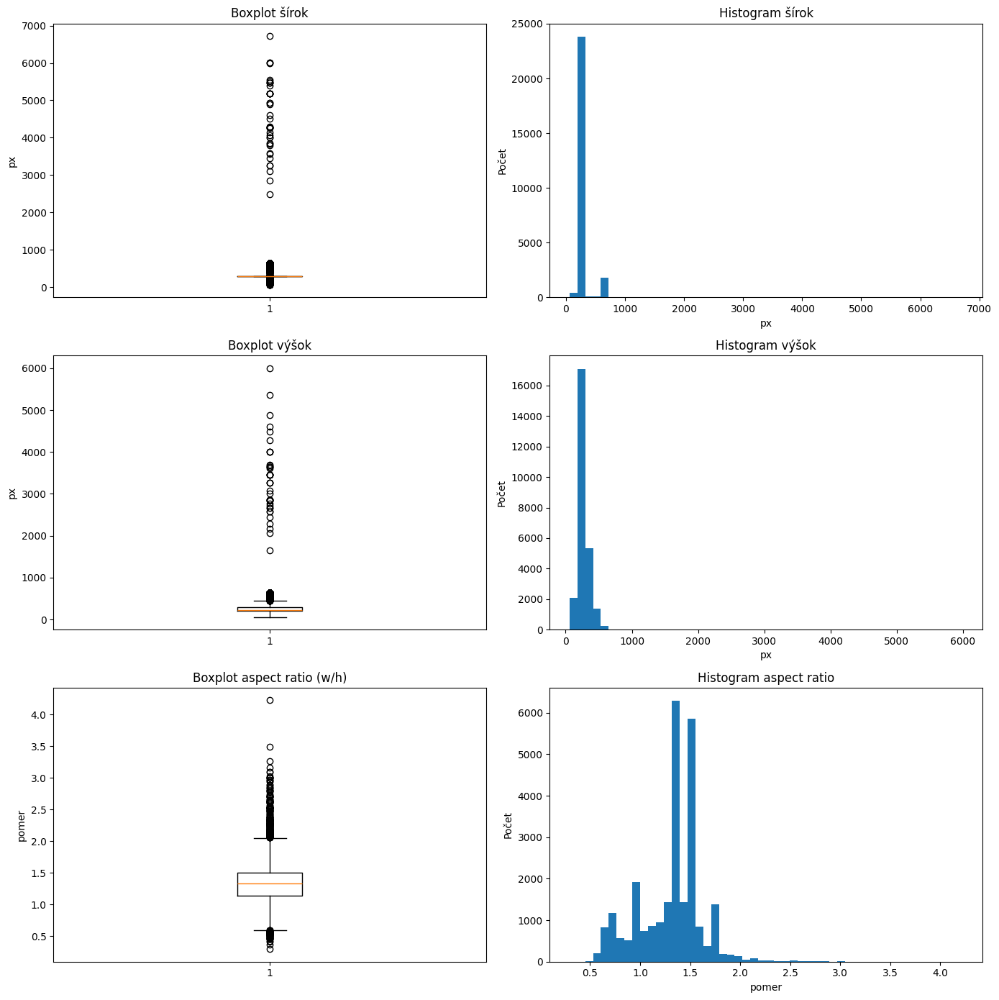

In [9]:
print(
    ANIMALS_DF[["width", "height", "aspect_ratio", "area"]]
    .describe()
    .round(2)
)

# Vyber si len validné riadky (bez NaN)
valid_df = ANIMALS_DF.dropna(subset=["width", "height", "aspect_ratio"])

widths = valid_df["width"].values
heights = valid_df["height"].values
aspect_ratios = valid_df["aspect_ratio"].values

fig, axs = plt.subplots(3, 2, figsize=(14, 14))

# --- Šírky (BOX + HIST) ---
axs[0, 0].boxplot(widths, vert=True)
axs[0, 0].set_title("Boxplot šírok")
axs[0, 0].set_ylabel("px")

axs[0, 1].hist(widths, bins=50)
axs[0, 1].set_title("Histogram šírok")
axs[0, 1].set_xlabel("px")
axs[0, 1].set_ylabel("Počet")

# --- Výšky (BOX + HIST) ---
axs[1, 0].boxplot(heights, vert=True)
axs[1, 0].set_title("Boxplot výšok")
axs[1, 0].set_ylabel("px")

axs[1, 1].hist(heights, bins=50)
axs[1, 1].set_title("Histogram výšok")
axs[1, 1].set_xlabel("px")
axs[1, 1].set_ylabel("Počet")

# --- Aspect Ratio (BOX + HIST) ---
axs[2, 0].boxplot(aspect_ratios, vert=True)
axs[2, 0].set_title("Boxplot aspect ratio (w/h)")
axs[2, 0].set_ylabel("pomer")

axs[2, 1].hist(aspect_ratios, bins=50)
axs[2, 1].set_title("Histogram aspect ratio")
axs[2, 1].set_xlabel("pomer")
axs[2, 1].set_ylabel("Počet")

plt.tight_layout()
plt.show()



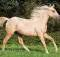
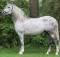
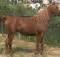
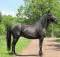
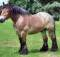
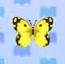
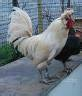
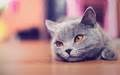
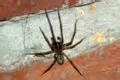
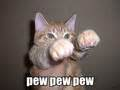

In [10]:
smallest = ANIMALS_DF.nsmallest(10, "area")
show_images(smallest, "Najmenšie obrázky (outliery)")



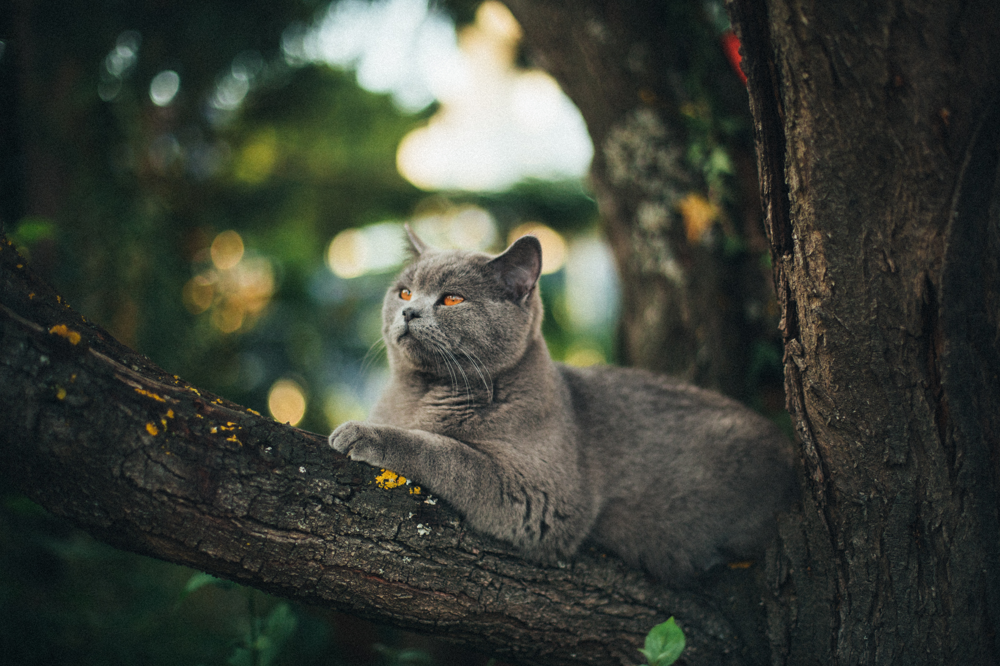
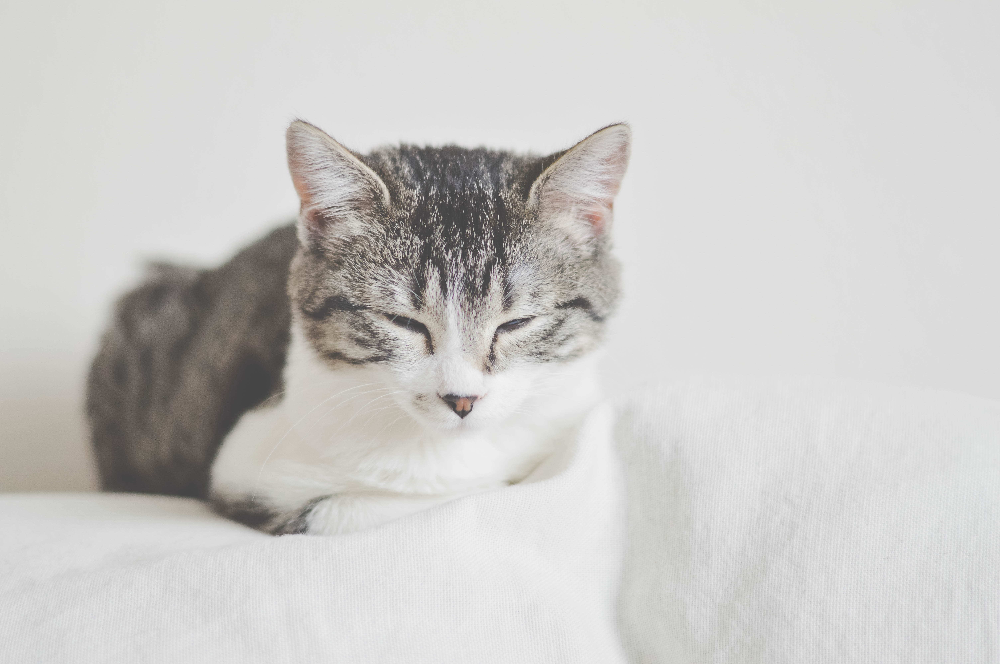
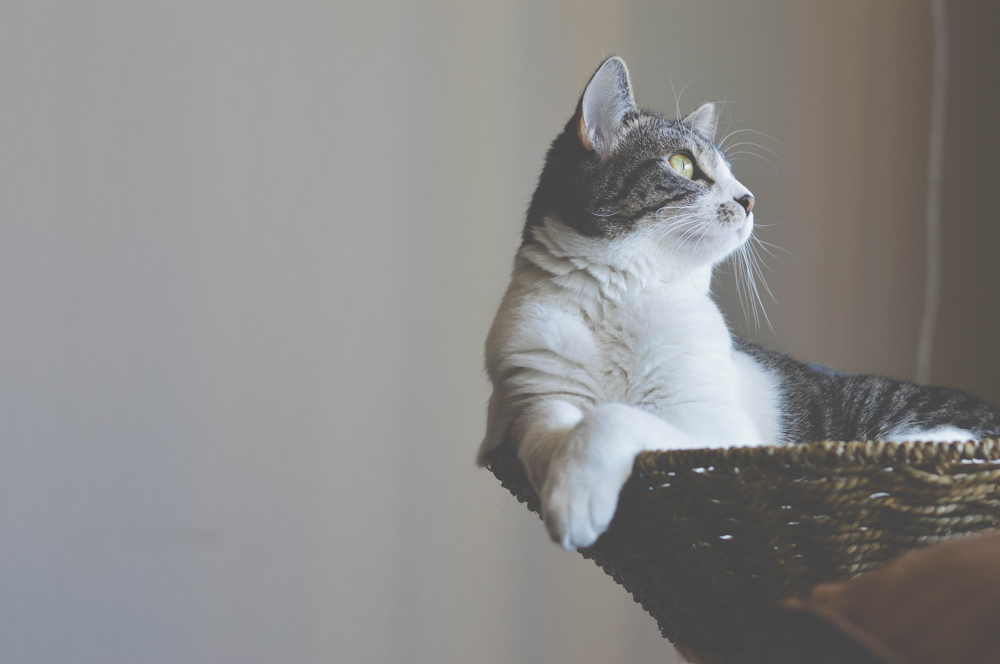
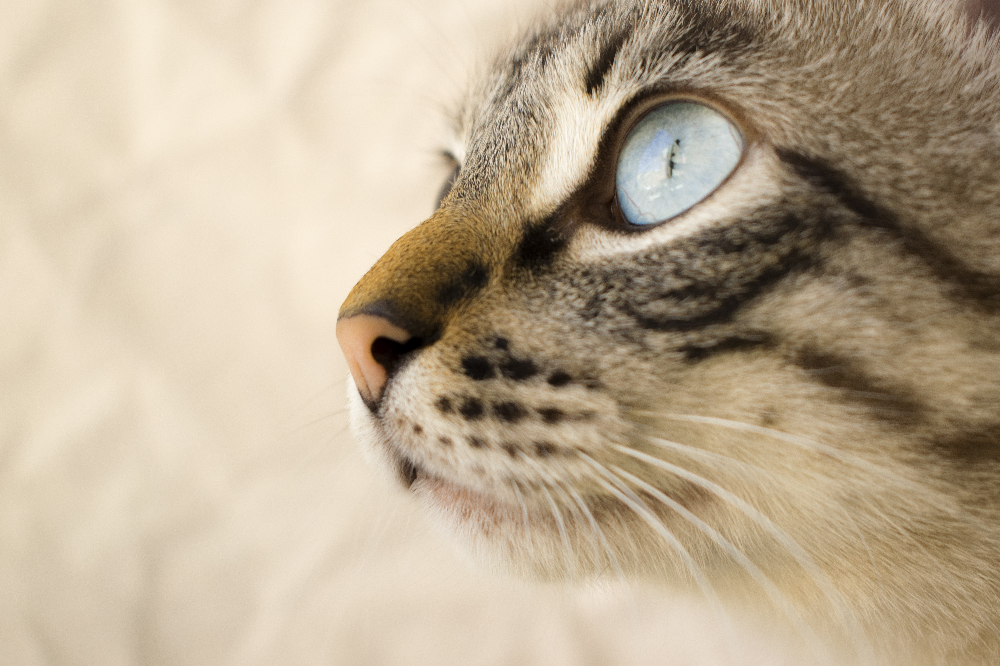
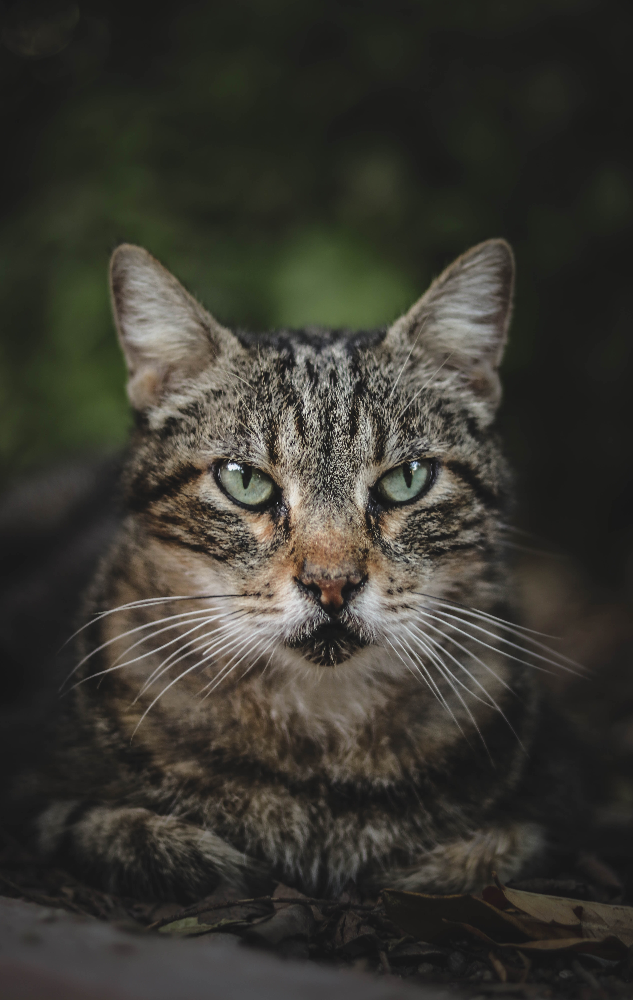
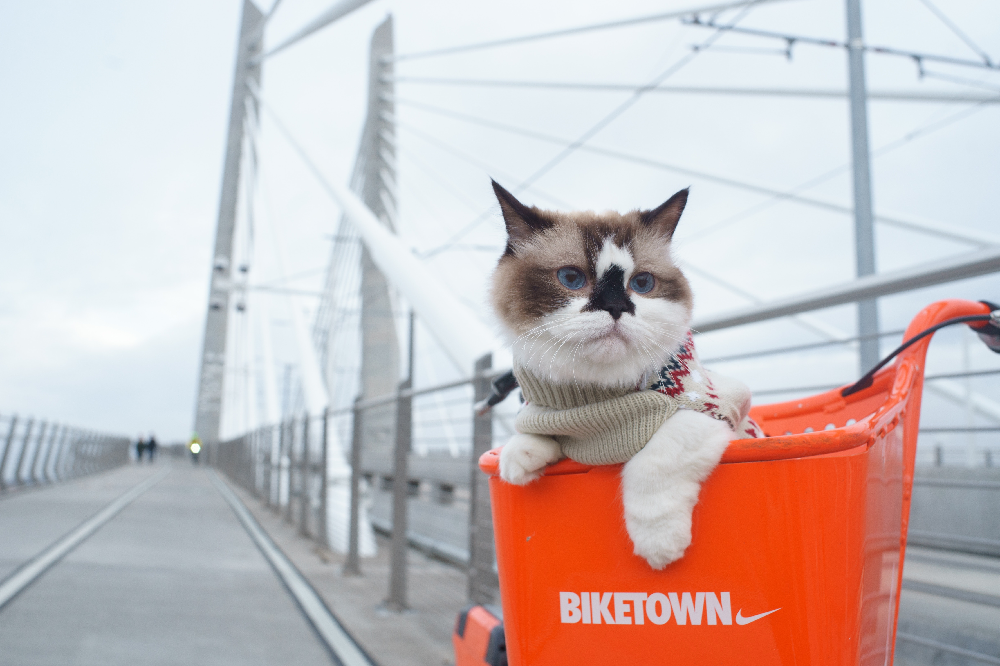
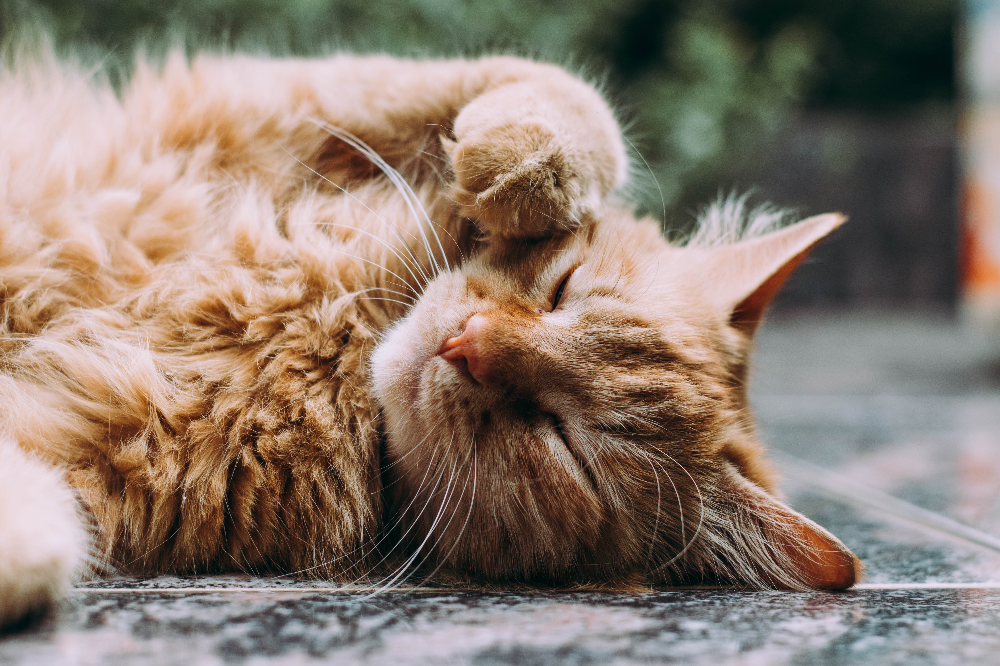
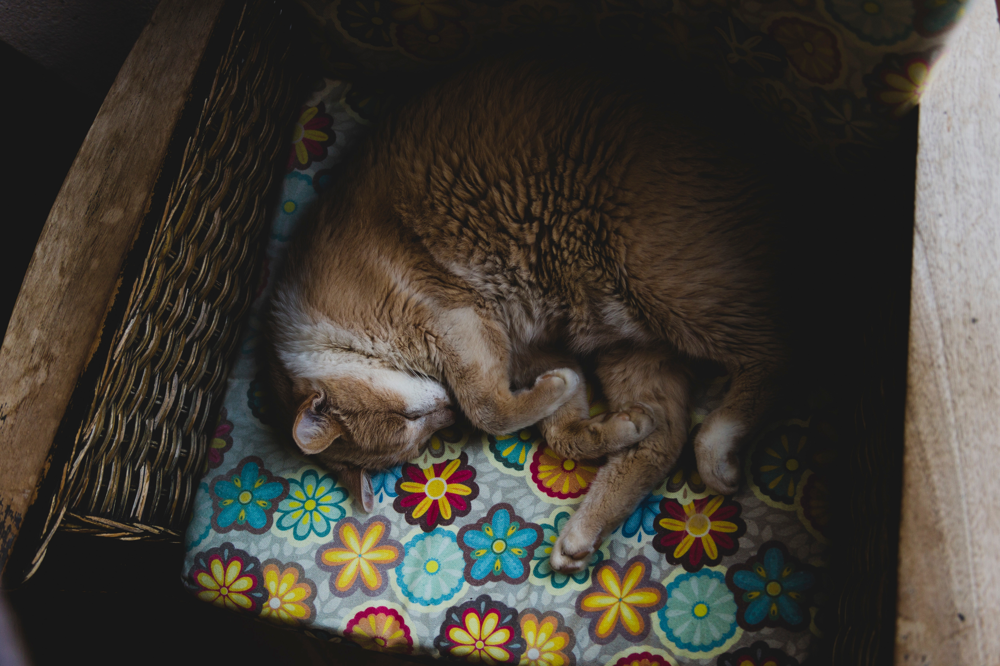
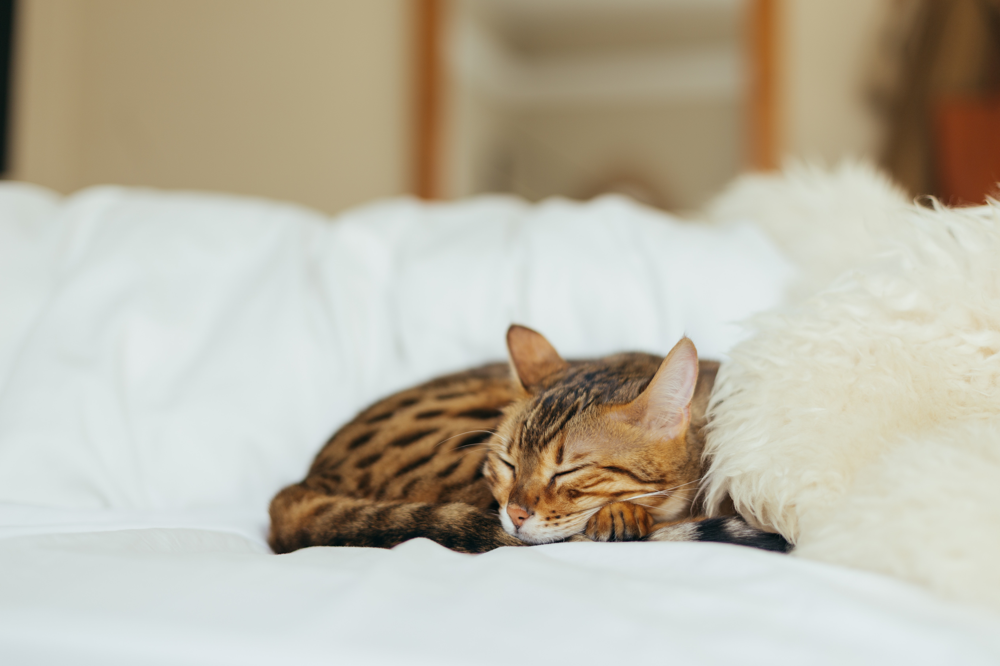
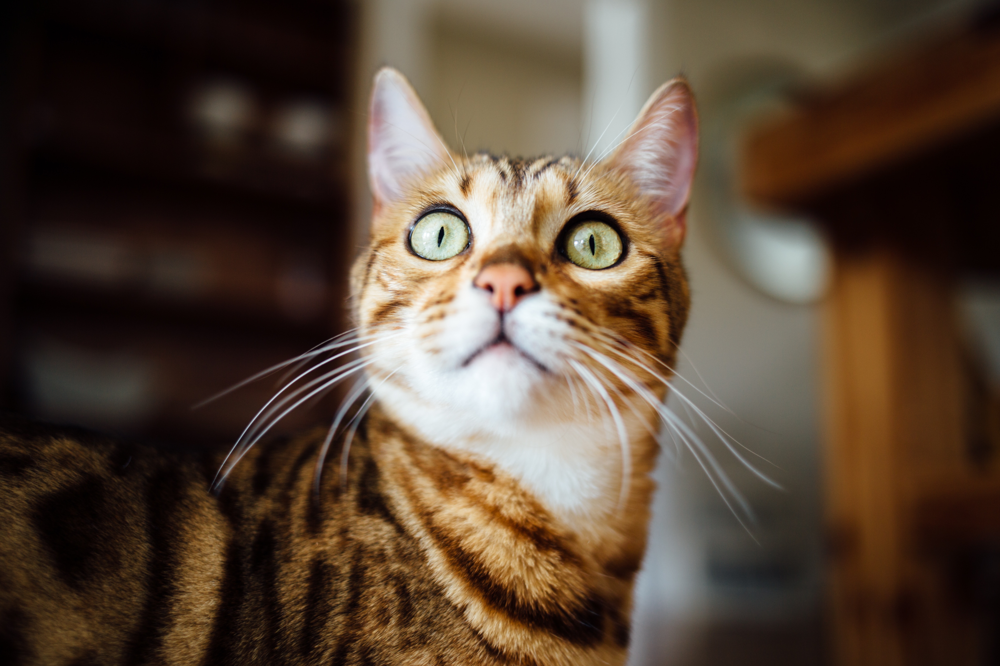

In [11]:
largest = ANIMALS_DF.nlargest(10, "area")
show_images(largest, "Najväčšie obrázky (outliery)")


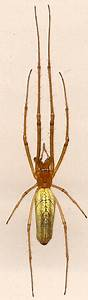
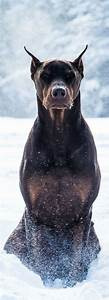
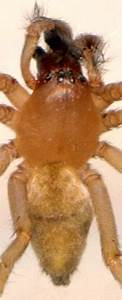
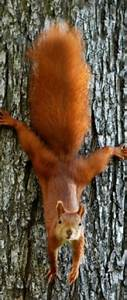
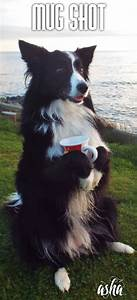
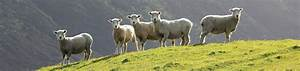
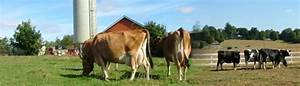
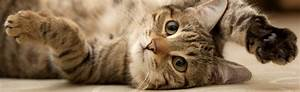
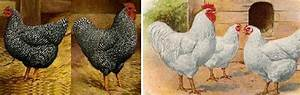
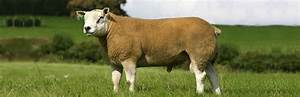

In [12]:
# animals_df["aspect_ratio"] = animals_df["width"] / animals_df["height"]
aspect_outliers = pd.concat([
    ANIMALS_DF.nsmallest(5, "aspect_ratio"),
    ANIMALS_DF.nlargest(5, "aspect_ratio")
])
show_images(aspect_outliers, "Najextrémnejšie aspect ratio")


In [13]:
ANIMALS_DF["bit_depth_label"] = ANIMALS_DF.apply(map_mode_to_depth, axis=1)
print(ANIMALS_DF["color_mode"].value_counts())
print(ANIMALS_DF["bit_depth"].value_counts())

color_mode
RGB     26128
RGBA       49
L           1
CMYK        1
Name: count, dtype: int64
bit_depth
8    26179
Name: count, dtype: int64


Computing RGB hist: 100%|██████████| 26179/26179 [01:12<00:00, 359.86it/s]


        value            R            G            B
count  256.00       256.00       256.00       256.00
mean   127.50  10884354.67  10884354.67  10884354.67
std     74.05   3168752.01   3369265.95   5409556.79
min      0.00   5316026.00   4538744.00   4831482.00
25%     63.75   9937121.25   9317389.25   7015874.25
50%    127.50  10994075.50  11162668.00  10029472.50
75%    191.25  12139950.50  12604577.00  13708859.75
max    255.00  48167585.00  47549130.00  64925237.00


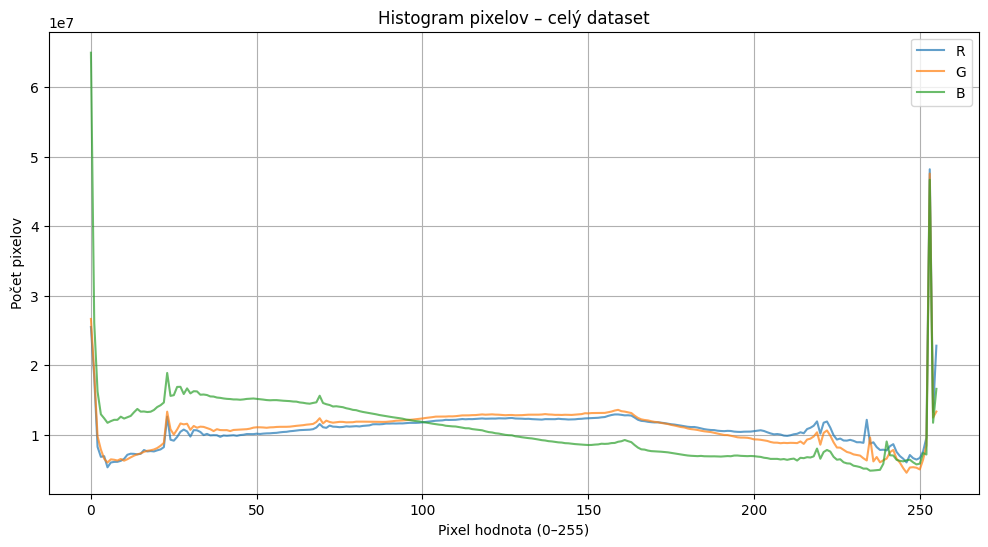

In [14]:
# Distribucia RGB pixelov
hist_R = np.zeros(256, dtype=np.int64)
hist_G = np.zeros(256, dtype=np.int64)
hist_B = np.zeros(256, dtype=np.int64)

for p in tqdm(ANIMALS_DF["filepath"], desc="Computing RGB hist"):
    try:
        img = Image.open(p).convert("RGB")
        arr = np.array(img)

        hR, _ = np.histogram(arr[:,:,0], bins=256, range=(0, 255))
        hG, _ = np.histogram(arr[:,:,1], bins=256, range=(0, 255))
        hB, _ = np.histogram(arr[:,:,2], bins=256, range=(0, 255))

        hist_R += hR
        hist_G += hG
        hist_B += hB

    except Exception as e:
        print("Error:", p, e)
        pass

# DataFrame pre lepšiu prácu
df_hist = pd.DataFrame({
    "value": np.arange(256),
    "R": hist_R,
    "G": hist_G,
    "B": hist_B
})

print(df_hist.describe().round(2))

plt.figure(figsize=(12, 6))
plt.plot(df_hist["value"], df_hist["R"], label="R", alpha=0.7)
plt.plot(df_hist["value"], df_hist["G"], label="G", alpha=0.7)
plt.plot(df_hist["value"], df_hist["B"], label="B", alpha=0.7)

plt.title("Histogram pixelov – celý dataset")
plt.xlabel("Pixel hodnota (0–255)")
plt.ylabel("Počet pixelov")
plt.legend()
plt.grid(True)
plt.show()


In [15]:
print(ANIMALS_DF["brightness"].describe().round(2))

count    26179.00
mean       121.60
std         36.22
min          0.00
25%         99.05
50%        117.58
75%        138.67
max        250.05
Name: brightness, dtype: float64



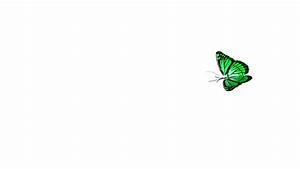
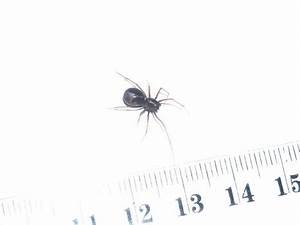
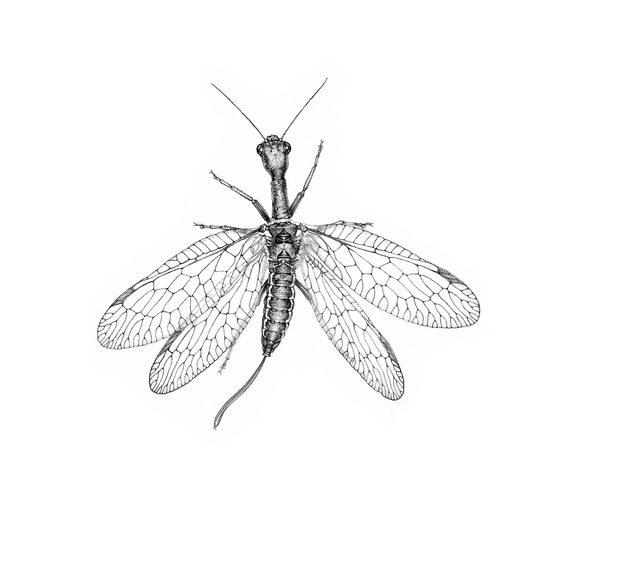
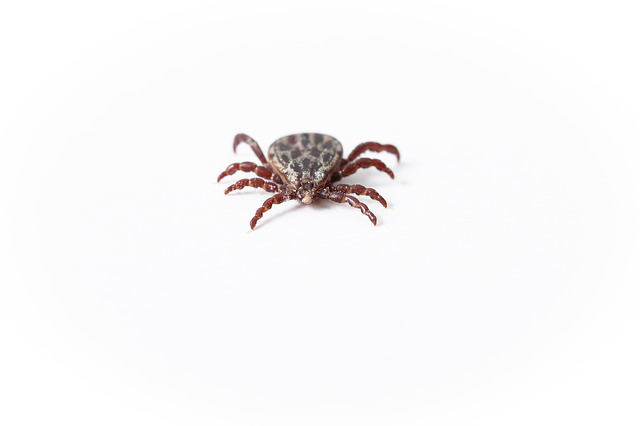
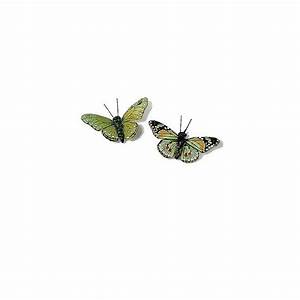
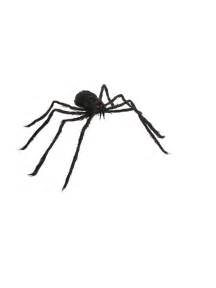
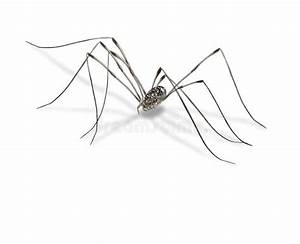
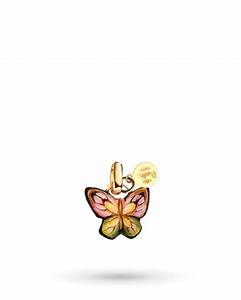
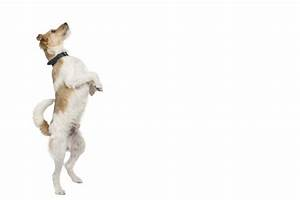
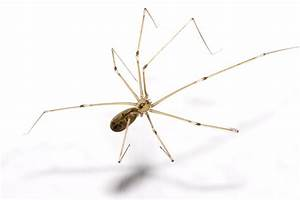

In [16]:
# svetle outliery nie su problem
# format .png (transparent) alebo white canvas (lepsie vidno edges)


show_images(
    ANIMALS_DF.nlargest(10, "brightness"),
    title="Najsvetlejšie obrázky"
)



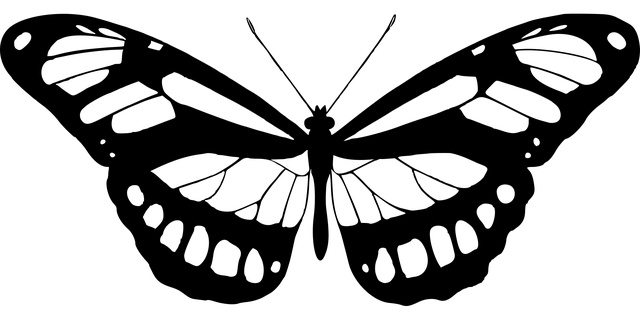
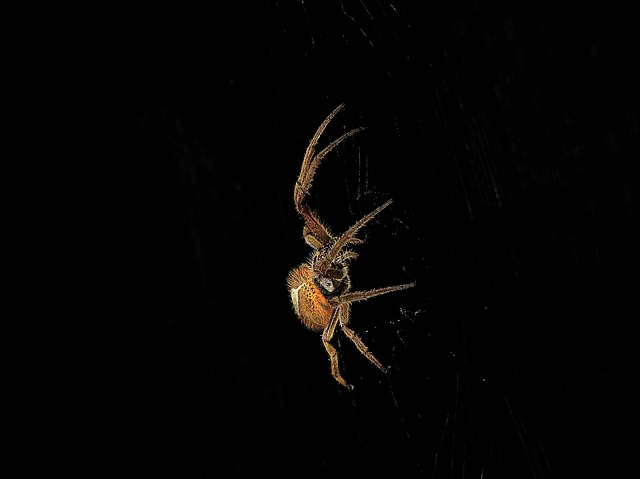
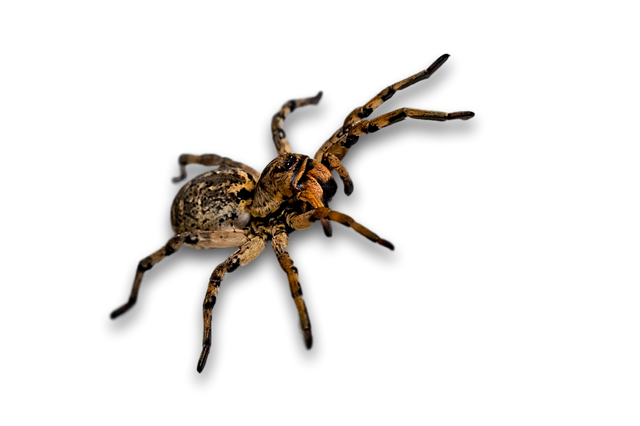
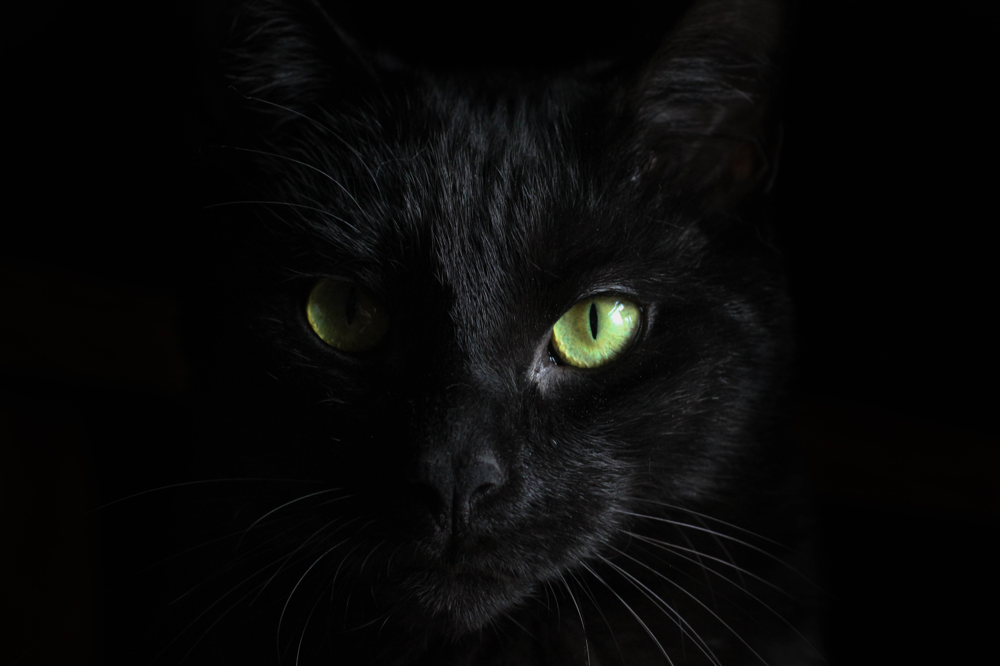
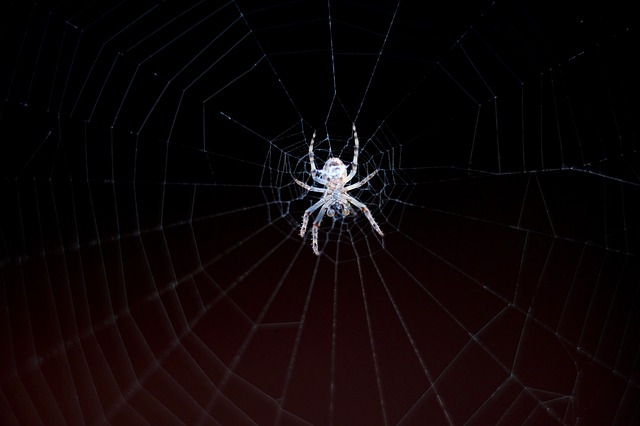
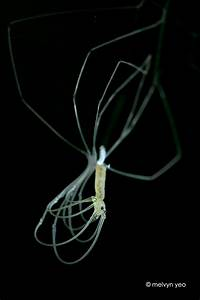
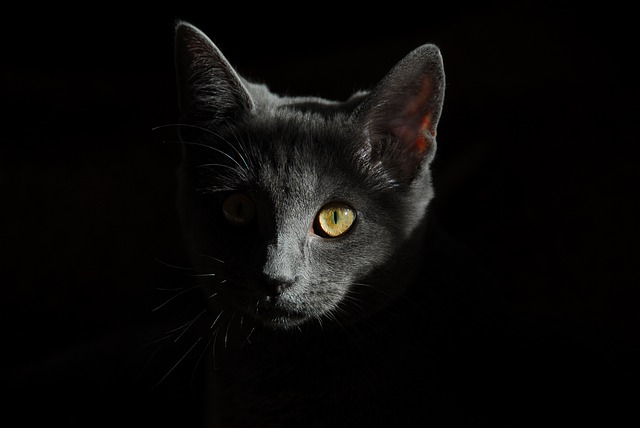
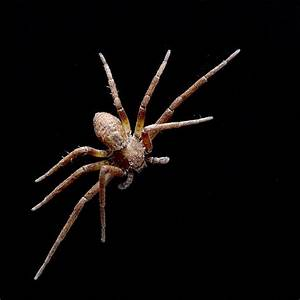
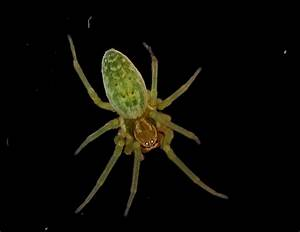
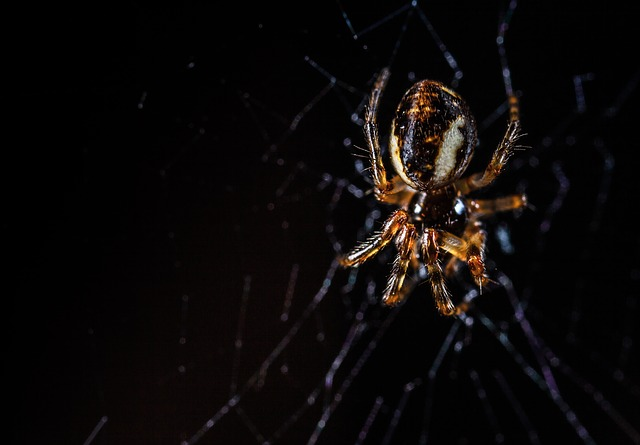

In [17]:
# tmave outliery nie su problem
# format .png (transparent) alebo black canvas (lepsie vidno edges)

show_images(
    ANIMALS_DF.nsmallest(10, "brightness"),
    title="Najtmavšie obrázky"
)


In [18]:
# oznacenie outlierov
ANIMALS_DF["is_outlier"] = (
        (ANIMALS_DF["aspect_ratio"] < 0.5) |
        (ANIMALS_DF["aspect_ratio"] > 2.0) |
        (ANIMALS_DF["area"] < 50000) |
        (ANIMALS_DF["area"] > 2_000_000)
)

In [19]:
MAX_SIZE = 500

In [21]:
# TESTING funkcnosti

def test_outlier(path, title):
    img = cv2.imread(path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    processed = center_pad_or_crop(img, 256, MAX_SIZE) # TODO: 256 treba zmenit

    print(f"\n=== {title} ===")
    print("Path:", path)
    print("Original:", img.shape)
    print("Processed:", processed.shape)
    print("is_outlier:", path in OUTLIERS)

    plt.figure(figsize=(12,4))

    plt.subplot(1,2,1)
    plt.title(f"{title} - Original")
    plt.imshow(img)
    plt.axis("off")

    plt.subplot(1,2,2)
    plt.title(f"{title} - Processed 256x256")
    plt.imshow(processed)
    plt.axis("off")

    plt.show()



# 1️⃣ RANDOM SMALL (area < 50k)
small = pick_random(ANIMALS_DF, ANIMALS_DF["area"] < 50000)
test_outlier(small, "RANDOM SMALL")

# 2️⃣ RANDOM LARGE (area > 2M)
large = pick_random(ANIMALS_DF, ANIMALS_DF["area"] > 2_000_000)
test_outlier(large, "RANDOM LARGE")

# 3️⃣ RANDOM NARROW (aspect < 0.5)
narrow = pick_random(ANIMALS_DF, ANIMALS_DF["aspect_ratio"] < 0.5)
test_outlier(narrow, "RANDOM NARROW")

# 4️⃣ RANDOM WIDE (aspect > 2.0)
wide = pick_random(ANIMALS_DF, ANIMALS_DF["aspect_ratio"] > 2.0)
test_outlier(wide, "RANDOM WIDE")

# 4️⃣ RANDOM CUSTOM (no outlier)
custom = pick_random_custom_size(ANIMALS_DF, target_h=1500, target_w=800, top_k=20)
test_outlier(custom, "RANDOM CUSTOM ~1000x800")

# 4️⃣ RANDOM CUSTOM (no outlier)
custom = pick_random_custom_size(ANIMALS_DF, target_h=500, target_w=400, top_k=20)
test_outlier(custom, "RANDOM CUSTOM ~500x400")


=== RANDOM SMALL ===
Path: data\archive\raw-img\farfalla\OIP-72Hmi5y1uSfZGSERrmZ3zwHaCu.jpeg
Original: (111, 300, 3)
Processed: (256, 256, 3)


NameError: name 'OUTLIERS' is not defined

In [ ]:
# Data split na train a test set
train_df, test_df = train_test_split(ANIMALS_DF, test_size=0.05, random_state=42)
train_df, val_df = train_test_split(train_df, test_size=0.0526, random_state=42)

In [ ]:
TARGET_SIZE = (256, 256)
MAX_SIZE = 500
BATCH_SIZE = 42
NUM_CLASSES = ANIMALS_DF.label.nunique()

# vypocet frekvencie augmentacie -> aby nebol model biasnuty iba na majoritne categorie obrazkov
counts = train_df.label.value_counts()
max_count = counts.max()
aug_strength = (max_count / counts).to_dict()

print(aug_strength)

train_gen = AnimalImageGenerator(
    df=train_df,
    batch_size=BATCH_SIZE,
    target_size=TARGET_SIZE,
    num_classes=NUM_CLASSES,
    augment=True,
    shuffle=True,
    aug_strength=aug_strength,
    max_size=MAX_SIZE
)

test_gen = AnimalImageGenerator(
    df=test_df,
    batch_size=BATCH_SIZE,
    target_size=TARGET_SIZE,
    num_classes=NUM_CLASSES,
    augment=False,
    shuffle=False,
    max_size=MAX_SIZE
)

val_gen = AnimalImageGenerator(
    df=val_df,
    batch_size=BATCH_SIZE,
    target_size=TARGET_SIZE,
    num_classes=NUM_CLASSES,
    augment=False,
    shuffle=False,
    max_size=MAX_SIZE
)


In [ ]:
images, labels = train_gen[0]     # zavolá __getitem__(0)
print("Images shape:", images.shape)
print("Labels shape:", labels.shape)
print("Image dtype:", images.dtype)
print("Label sample:", labels[0])

2. Precission, recall, f1-score (evaluation matrcis), accuracy
3. Confusion matrix
4. ROC krivka
1. Heatmpas

- keras (resize, no aspect ratio)  vs manual (cenetering and apdding)
- ELA

Grad-CAM,EfficentNetB7

Poznamky s konzultacie:
- Pozriet efektivnost efficientNetB7 - stavanie siete vlastnej
- Grad-CAM za bonusovy bod
- Split kludne na 10 %
- Kontrola či su outlayery v pohode po preprocesingu (mozme sparvit centering a padding)
- Zvážiť použitie F1-score vylepsenej
- bias datasetov - niektore triedy su viac reprezentovane (tam potom viac augemtacie, ina priorita evalucie)